**Tabla de contenido**

- [Introducción](#Intro)
- [Librerías](#Lib)
- [Lectura de datos](#Lectura-de-datos)
- [EDA](#EDA)
    - [Serie de temperatura](#Serie-de-temperatura)
    - [Periodicidad](#Periodicidad)
    - [Prueba de estacionariedad](#Prueba-de-estacionariedad)
        - [Dickey-Fuller aumentada](#Dickey-Fuller-aumentada)
    - [Descompocisión de la serie](#Descompocision-de-la-serie)
    - [Transformada de fourier](#Transformada-de-fourier)
    - [Autocorrelación](#Autocorrelacion)
    - [Resumen](#Resumen)
- [Prepara datos](#Prepara-datos)
    - [train val test](#train-val-test)
    - [Estandarización](#Estandariza)
    - [Tf data Dataset](#Tf-data-Dataset)
- [Modelado](#Modelado)
    - [Guarda modelo](#Guarda-modelo)
    - [Predicciones](#Predicciones)

# Intro

En este cuaderno, realizaremos un análisis exploratorio a la serie de tiempo de temperatura y entrenaremos una red LSTM para predecir la temperatura.

**Teoria a tener en cuenta**

**Componentes de una serie de tiempo**

En general una serie de tiempo tiene 3 componentes principales:

- **Estacionalidad:** Una serie de tiempo es estacional cuando alcanza picos máximos y valles mínimos que se repiten periodicamente y de manera predecible en el tiempo.
- **Nivel:** Es el valor promedio que va a tener la serie a lo largo del tiempo y nos da una medida o estimación de los valores centrales que va a tener la serie de tiempo.
- **Tendencia:** Es el incremento o reducción que pueden tener los valores de una serie a lo largo del tiempo.

**Qué es una serie de tiempo cíclica?** Una serie de tiempo es cíclica cuando alcanza picos y valles, pero estos no se repiten periodicamente en el tiempo. Las acciones tienen comportamientos cíclicos, por lo cual es más díficil hacer predicciones.

**Estacionariedad y autocorrelación**

Una serie de tiempo es estacionaria si sus propiedades estadísticas se conservan en el tiempo. En términos más concretos, la media y la varianza de una serie estacionaria no cambian con el tiempo, y tampoco siguen una tendencia.

La **autocorrelación** permite comparar la señal consigo misma y es útil para identificar por ejemplo, patrones de estacionalidad o tendencias lineales.


# Lib

In [1]:
import pandas as pd
import numpy as np
from pathlib import Path
import plotly
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler

from sklearn.metrics import r2_score, mean_squared_error

2025-05-27 12:20:38.962090: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1748366438.978728   87748 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1748366438.983448   87748 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1748366438.995258   87748 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1748366438.995276   87748 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1748366438.995277   87748 computation_placer.cc:177] computation placer alr

# Lectura de datos

In [2]:
# Lectura de datos
path = Path(r'/media/luisgarcia/Datos/19. Proyectos deepLearning/Forescating lstm')
csv = path /'jena_climate_2009_2016.csv'
df = pd.read_csv(csv)
# convertir fecha a datetime
df['Date Time'] = pd.to_datetime(df['Date Time'], format='%d.%m.%Y %H:%M:%S')
# organicemos el dataframe con respecto al tiempo
df = df.sort_values(by='Date Time', ascending= True)
df.head(3)

,Date Time,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
0,2009-01-01 00:10:00,996.52,-8.02,265.40,-8.90,93.3,3.33,3.11,0.22,1.94,3.12,1307.75,1.03,1.75,152.3
1,2009-01-01 00:20:00,996.57,-8.41,265.01,-9.28,93.4,3.23,3.02,0.21,1.89,3.03,1309.80,0.72,1.50,136.1
2,2009-01-01 00:30:00,996.53,-8.51,264.91,-9.31,93.9,3.21,3.01,0.20,1.88,3.02,1310.24,0.19,0.63,171.6


# EDA

## Serie de temperatura

In [3]:
def plot_time_series(df, x_var, y_var, title, xaxis_title, yaxis_title,dash='dash'):
    # Asegurar que la variable del eje x esté en formato datetime
    if not df[x_var].dtype.name.startswith('datetime'):
        df[x_var] = pd.to_datetime(df[x_var])

    # Crear figura
    fig = go.Figure()

    # Agregar la serie con línea punteada
    fig.add_trace(go.Scatter(
        x=df[x_var],
        y=df[y_var],
        mode='lines',
        name=y_var.replace('_', ' ').capitalize(),
        line=dict(color='blue', width=2, dash=dash)
    ))

    # Actualizar diseño
    fig.update_layout(
        title=f'<b>{title}</b>',
        title_font=dict(size=20, family='Arial', color='black'),
        xaxis_title=f'<b>{xaxis_title}</b>',
        yaxis_title=f'<b>{yaxis_title}</b>',
        font=dict(family='Arial', size=12, color='black'),
        plot_bgcolor='white',
        paper_bgcolor='white',
        hovermode='x unified',
        height=400,
        margin=dict(l=50, r=50, b=50, t=80)
    )

    # Formato año-mes en eje x
    fig.update_xaxes(showgrid=True, gridcolor='lightgray', tickformat='%Y-%m')
    fig.update_yaxes(showgrid=True, gridcolor='lightgray')

    fig.show()
    return fig

In [4]:
fig =plot_time_series(df, 'Date Time', 'T (degC)', 
                 title='Comportamiento de la temperatura',
                 xaxis_title='Fecha',
                 yaxis_title='Temperatura',
                     dash='dash')

Podemos observar que la serie no presenta una tendencia clara. A continuación, veamos cómo se comporta la serie al seleccionar únicamente los datos correspondientes a horas exactas.

In [5]:
dfH= df[df['Date Time'].dt.minute==0]
fig =plot_time_series(dfH, 'Date Time', 'T (degC)', 
                 title='Comportamiento de la temperatura cada hora',
                 xaxis_title='Fecha',
                 yaxis_title='Temperatura',
                     dash='dash')

## Periodicidad

Veamos con que frecuencia están los datos, pero antes eliminemos los datos duplicados.

In [6]:
dfH = dfH.drop_duplicates(subset=['Date Time'], keep = 'first')
dfH = dfH.set_index('Date Time', drop=True)
dif = dfH.index.to_series().diff().dt.total_seconds()
dif = dif.value_counts().reset_index()
dif.columns =['Segundos','cantidad']
dif['Horas'] = dif['Segundos']/3600
dif.head()

,Segundos,cantidad,Horas
0,3600.0,70032,1.0
1,7200.0,2,2.0
2,57600.0,1,16.0
3,270000.0,1,75.0


- Hay dos datos con dos horas de diferencia.
- Hay un dato con 16 horas de diferencia.
- Hay un datos con 75 horas de diferencia.

Corrijamos esto usando el método bfill, que llena los valores faltantes hacia atrás, utilizando el valor más cercano en el futuro.

In [7]:
dfHC = dfH.asfreq(freq='h',method='bfill')

## Prueba de estacionariedad

- **Prueba de Dickey-Fuller aumentada:** La prueba **Dickey-Fuller aumentada (ADF)** se utiliza para **evaluar la presencia de una raíz unitaria**, lo que indica **no estacionariedad en una serie de tiempo**. La **hipótesis nula** afirma **la existencia de una raíz unitaria**, mientras que la **hipótesis alternativa** propone la **estacionariedad**. La prueba ADF **se basa** en el **valor p** para determinar la **estacionariedad** de la serie. Si el valor p cae por debajo del nivel de significancia, comúnmente establecido en 0,05, se rechaza la hipótesis nula, lo que lleva a la conclusión de estacionariedad. Por el contrario, si el **valor p** supera el **nivel de significancia**, la serie se considera no estacionaria.


- **Prueba de Kwiatkowski-Phillips-Schmidt-Shin:** La prueba **Kwiatkowski–Phillips–Schmidt–Shin (KPSS)** está diseñada para **evaluar la estacionariedad** de una serie temporal examinando sus **componentes de tendencia y estacionalidad**. En esta prueba, la **hipótesis nula** asume **estacionariedad**, mientras que la **hipótesis alternativa** sugiere **no estacionariedad**. Rechazar la hipótesis nula en el contexto de la prueba KPSS significa la presencia de no estacionariedad. Específicamente, si el valor p está por debajo del nivel de significancia, se rechaza la estacionariedad. Por el contrario, si el valor p supera el nivel de significancia, generalmente establecido en 0,05, no se rechaza la estacionariedad y, por lo tanto, se puede asumir que los datos son estacionarios.

### Dickey-Fuller aumentada

- **Hipótesis nula (H0)**: La serie temporal tiene una raíz unitaria (no es estacionaria), esto implica, una tendencia estocástica (variación no constante), y dependencia fuerte de valores pasados (autocorrelación).
- **Hipótesis alternativa (H1)**: La serie temporal no tiene raíz unitaria (es estacionaria), es decir, Media y varianza constantes en el tiempo; Autocorrelación que decae rápidamente.


**Interpretación del p-value:**

- Si **p-value≤0.05**: Rechazas H0 y concluyes que la serie es estacionaria (no tiene raíz unitaria).

- Si **p-value>0.05**: No hay evidencia suficiente para rechazar H0 por lo que la serie no es estacionaria.

In [8]:
from statsmodels.tsa.stattools import adfuller
time_series = dfH['T (degC)']
# Realiza la prueba ADF
adf_result = adfuller(time_series, autolag='AIC')  # 'AIC' es un criterio para seleccionar el retraso óptimo
# Imprime los resultados
print(f'ADF Statistic: {adf_result[0]}')
print(f'p-value: {adf_result[1]}')
print('Valores críticos:')
for key, value in adf_result[4].items():
    print(f'   {key}: {value}')

ADF Statistic: -8.548454413897524
p-value: 9.363409477776083e-14
Valores críticos:
   1%: -3.43044345671114
   5%: -2.861581306206825
   10%: -2.5667919858825203


Podemos observar que el **valor p-value**: *9.363409477776083e-14 * < a *0.05*, en este caso se rechaza H0, concluyendo que la serie **es estacionaria**, es decir, Media y varianza constantes en el tiempo. esto indica que **no necesito diferenciar la serie**.

# Descompocision de la serie

Vamos a descomponer la serie de tiempo con los siguientes tres métodos:

-  **Descomposición aditiva**: La idea de la descomposición clásica es expresar la serie de tiempo ($y(t)$) como una combinación de tres componentes:
    - $S(t)$: estacionalidad
    - $T(t)$: tendencia
    - $R(t)$: residual (componente de error asociado a la descomposición).

De esta forma la serie se expresa de la forma :$$y(t) = S(t) + T(t) + R(t)$$
Esta descomposición es "adecuada" cuando la magnitud del componente estacional se mantiene relativamente constante a pesar de la tendencia.
-  **Descomposición multiplicativa** = S(t)*T(t)*R(t)

Esta descomposición es "adecuada" cuando la magnitud del componente estacional cambia proporcionalmente con la tendencia (como en el caso de la serie del flujo de pasajeros).

-  **Descomposición STL**: Las siglas en el nombre de esta descomposición corresponden a "Seasonal and Trend decomposition using Loess".

En últimas esta descomposición también permite obtener los tres componentes (tendencia, estacionalidad y residuales) pero usa un método más sofisticado que la descomposición clásica.

La idea básica es:

1. Se estima la estacionalidad de la serie usando lo que se conoce como "local regression (Loess)": se promedian "N" datos vecinos (donde "N" depende de la periodicidad aproximada de la serie)
2. Habiendo estimado la estacionalidad se elimina de la serie original (*Serie resultante = serie original - estacionalidad*) y como resultado se tendría la tendencia y el ruido en la serie
3. A la serie que resulta en (2) se le aplica nuevamente el método Loess con un "N" diferente al usado al estimar la estacionalidad. Con esto se determinan las variaciones a largo plazo de la serie (es decir la tendencia)
4. Finalmente el residual será el resultado de tomar la serie original y restarle la estacionalidad (paso 1) y la tendencia (paso 3)

En general este método produce mejores descomposiciones en comparación con el método clásico (es más robusto).

La mejor descomposición será en la que el promedio de los residuos, sea minimo.

In [9]:
from statsmodels.tsa.seasonal import seasonal_decompose, STL
# descomposición aditiva
T_comps_add = seasonal_decompose(dfHC['T (degC)'],model='additive')# descomposición aditiva
#T_comps_mul = seasonal_decompose(dfHC['T (degC)'],model='multiplicative')# descomposición multipli
T_stl = STL(dfHC['T (degC)']).fit()
print(f'Promedio residuales descomposición aditiva: {T_comps_add.resid.mean()}')
#print(f'Promedio residuales descomposición multiplicativa: {T_comps_mul.resid.mean()}')
print(f'Promedio residuales descomposición STL: {T_stl.resid.mean()}')

Promedio residuales descomposición aditiva: -0.00015285920441960514
Promedio residuales descomposición STL: -0.0002160617676791065


La variable `T_comps_add` contendrá los diferentes elementos de la descomposición así como la serie original:

- Atributo `observed`: serie de tiempo original
- Atributo `seasonal`: componente estacional
- Atributo `trend`: tendencia
- Atributo `resid`: residuales

**La mejor descomposición fue la aditiva, es más cercana a cero.**

In [10]:
# Extraer componentes
observed = T_comps_add.observed
trend = T_comps_add.trend
seasonal = T_comps_add.seasonal
residual = T_comps_add.resid

# Crear figura con subplots
fig = make_subplots(
    rows=4, cols=1,
    shared_xaxes=True,
    subplot_titles=(
        "<b>Observado</b>", 
        "<b>Tendencia</b>", 
        "<b>Estacionalidad</b>", 
        "<b>Residuales</b>"
    )
)

# Añadir trazas
fig.add_trace(go.Scatter(x=observed.index, y=observed, name='Observado'), row=1, col=1)
fig.add_trace(go.Scatter(x=trend.index, y=trend, name='Tendencia'), row=2, col=1)
fig.add_trace(go.Scatter(x=seasonal.index, y=seasonal, name='Estacionalidad'), row=3, col=1)
fig.add_trace(go.Scatter(x=residual.index, y=residual, name='Residuales'), row=4, col=1)

# Actualizar diseño (según tu especificación)
fig.update_layout(
    title='<b>Descomposición Aditiva de la Temperatura</b>',
    title_font=dict(size=20, family='Arial', color='black'),
    font=dict(family='Arial', size=12, color='black'),
    plot_bgcolor='white',
    paper_bgcolor='white',
    hovermode='x unified',
    height=600,  # Ajustado para 4 subplots
    width=800,
    margin=dict(l=50, r=50, b=50, t=80),
    showlegend=False
)

# Ajustar ejes y títulos de ejes (opcional)
fig.update_xaxes(title_text='<b>Fecha</b>', row=4, col=1)  # Solo se muestra en el último subplot
fig.update_yaxes(title_text='<b>Temperatura (°C)</b>', row=1, col=1)
fig.update_yaxes(title_text='<b>Tendencia</b>', row=2, col=1)
fig.update_yaxes(title_text='<b>Estacionalidad</b>', row=3, col=1)
fig.update_yaxes(title_text='<b>Residuales</b>', row=4, col=1)

# Mostrar figura
fig.show()

- **Análisis de la tendencia:**
Se identifica un patrón cíclico en la temperatura, con oscilaciones entre aproximadamente -20°C y 20°C. Los valores mínimos suelen registrarse en enero, mientras que los máximos ocurren entre julio y agosto, lo que sugiere una estacionalidad anual marcada.

- **Análisis de la estacionalidad diaria:**
La componente estacional revela fluctuaciones intraday, con un pico máximo y un mínimo diarios, lo que indica variaciones recurrentes de temperatura a lo largo del día (ascensos durante las horas centrales y descensos en la noche/madrugada).

## Transformada de fourier

La **transformada de fourier** asume que la serie o **señal** que está analizando **es estacionaria**. El objetivo es análisis el contenido de la serie en términos de frecuencia.

La **Transformada de Fourier** descompone la serie temporal en sus **componentes sinusoidales**, revelando qué **frecuencias contribuyen más a la variabilidad de los datos**.

In [11]:
N = len(dfHC['T (degC)'])
muestras_hora = 1
# calcula magnitud de la transformada de fourier lado derecho
tfT = np.abs(np.fft.rfft(dfHC['T (degC)'],N))
# calcular el vector frecuencia
frec = np.fft.rfftfreq(N,d=1./muestras_hora)

In [12]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=frec, y=tfT,
                         mode='lines', name='Close', 
                         line=dict(color='blue', width=1)))
fig.update_layout(
    xaxis=dict(type="log"),
    title="Transformada de Fourier",
    xaxis_title="Frecuencia (ciclos por hora)",
    yaxis_title="Amplitud",
    template="plotly_white"
)

Podemos observar que hay varias frecuencias dominantes:

1. 114.0771u = 114.0771 x 10-6 ciclos/ hora
2. 0.04166667 ciclos/ hora
3. 0.0833333 ciclos/hora

Al usar la formula para convertir estas frecuencias a periodos:
$$P = 1/f$$  Obtenemos

1. $$P = 1 ciclo/114.0771 x 10-6 ciclos/ hora = 8766.001 horas * 1 dia/24 horas = 365.25 dias$$ Esto indica un patrón de largo plazo, correspondiente a una **estacionalidad anual**.
2. $$P = 1 ciclo/0.04166667 ciclos/ hora = 24 horas $$  Esto representa un **patrón diario**, que sugiere una fuerte ciclicidad cada día.
3. $$P = 1 ciclo/0.083333 ciclos/ hora = 12 horas $$ Indica un patrón de corto plazo, con una **repetición cada 12 horas**, posiblemente asociado a cambios entre día y noche.

## Autocorrelacion

Para una serie temporal \( X_t \) con media \( \mu \) y varianza \( \sigma^2 \), la función de autocorrelación en el retardo \( k \) se define como:

$$
\rho(k) = \frac{\text{Cov}(X_t, X_{t-k})}{\text{Var}(X_t)} = \frac{\mathbb{E}[(X_t - \mu)(X_{t-k} - \mu)]}{\sigma^2}
$$

**Donde:**  
- $\rho(k)$: Coeficiente de autocorrelación en el retardo $k$  
- $\text{Cov}(X_t, X_{t-k})$: Covarianza entre $X_t$ y $X_{t-k}$  
- $\text{Var}(X_t)$: Varianza de la serie  
- $\mathbb{E}[\cdot]$: Valor esperado  
- $\mu$: Media de la serie  
- $\sigma^2$: Varianza ($\sigma$ es desviación estándar)   


1. Media ($\mu$)
Valor esperado de la serie temporal $X_t$:  

$$
\mu = \mathbb{E}[X_t] = \begin{cases}
\frac{1}{N}\sum_{t=1}^{N} X_t & \text{(muestral)} \\
\int_{-\infty}^{\infty} x f(x)dx & \text{(poblacional, continua)}
\end{cases}
$$

2. Varianza ($\sigma^2$)  
Medida de dispersión alrededor de la media:  

$$
\sigma^2 = \text{Var}(X_t) = \mathbb{E}[(X_t - \mu)^2] = \begin{cases}
\frac{1}{N}\sum_{t=1}^{N} (X_t - \mu)^2 & \text{(muestral)} \\
\mathbb{E}[X_t^2] - (\mathbb{E}[X_t])^2 & \text{(poblacional)}
\end{cases}
$$

3. Covarianza  
Medida de dependencia lineal entre $X_t$ y $X_{t-k}$:  

$$
\text{Cov}(X_t, X_{t-k}) = \mathbb{E}[(X_t - \mu)(X_{t-k} - \mu)] = \begin{cases}
\frac{1}{N}\sum_{t=k+1}^{N} (X_t - \mu)(X_{t-k} - \mu) & \text{(muestral)} \\
\mathbb{E}[X_t X_{t-k}] - \mu^2 & \text{(poblacional)}
\end{cases}
$$

**Notas:**  
- En versiones muestrales, $N$ es el número de observaciones  
- Para series estacionarias, $\text{Var}(X_t) = \text{Var}(X_{t-k})$  
- $\text{Cov}(X_t, X_{t-k})$ se denomina **autocovarianza** cuando $k \neq 0$


**Interpretación de la autocorrelación:**

La autocorrelación en el retardo *k* mide que tanto se parece la serie así misma desplazada *k unidades* en el tiempo ajustando por su media y varianza.

- **autocorrelación ≈ 1:** hay alta similitud entre $\text(X_t) y (X_{t-k})$. Indicando un comportamiento repetitivo o predecible con k periodos de retrazo.
- **autocorrelación ≈ 0:** No hay relación. El valor actual y el de hace *k* pasos no tiene conexión lineal.
-  **autocorrelación ≈ -1:** Hay una relación inversa fuerte, cuando el uno sube, el otro tiende a bajar.

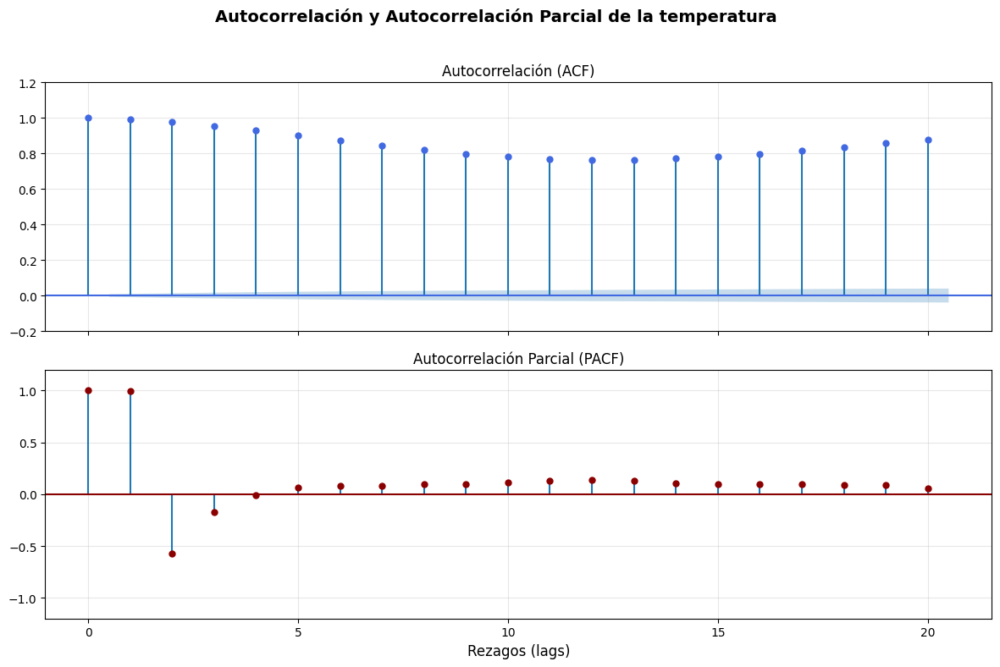

In [13]:
import matplotlib.pyplot as plt 
import statsmodels.api as sm
fig, ax = plt.subplots(2, 1, figsize=(12, 8), sharex=True)  # Tamaño y ejes compartidos
fig.suptitle('Autocorrelación y Autocorrelación Parcial de la temperatura', fontsize=14, fontweight='bold')

# ACF
sm.graphics.tsa.plot_acf(dfHC['T (degC)'].dropna(), lags=20, ax=ax[0], color='royalblue')
ax[0].set_title('Autocorrelación (ACF)', fontsize=12)
ax[0].grid(alpha=0.3)
ax[0].set_ylim(-0.2, 1.2) 

# PACF
sm.graphics.tsa.plot_pacf(dfHC['T (degC)'].dropna(), lags=20, ax=ax[1], method='yw', color='darkred')
ax[1].set_title('Autocorrelación Parcial (PACF)', fontsize=12)
ax[1].grid(alpha=0.3)

plt.xlabel('Rezagos (lags)', fontsize=12)
plt.tight_layout(rect=[0, 0, 1, 0.96])  # Ajustar para que el título no se solape
ax[1].set_ylim(-1.2, 1.2) 
plt.show()

## Resumen

**Resumen de análisis:**

- La prueba de **Dickey-Fuller aumentada** confirmó que **la serie es estacionaria**, lo que implica que su media y varianza se mantienen constantes en el tiempo.

- Mediante la **transformada de Fourier** se identificaron patrones cíclicos bien definidos:

    - Estacionalidad anual (~365.25 días).
    
    - Ciclo diario (cada 24 horas).
    
    - Patrón de corto plazo (cada 12 horas).

# Prepara datos

1) En primer lugar, se dividirán los datos en conjuntos de entrenamiento, validación y prueba.
2) Posteriormente, se estandarizarán los datos para que tengan una media de 0 y una desviación estándar de 1.
3) Finalmente, los datos se organizarán en secuencias de 24 registros.

## train val test

In [14]:
dfHC = dfHC.drop(columns=['Tpot (K)','Tdew (degC)'], axis=1)
independientes = dfHC.drop(columns = ['T (degC)'], axis=1)
target = dfHC['T (degC)']
# divide en X, test
X, X_test, Y, Y_test = train_test_split(independientes,
                                        target,
                                        test_size=0.1,
                                        shuffle = False,
                                        random_state=24)
# divide en X_train y X_valid
X_train, X_val, Y_train, Y_val = train_test_split(X,
                                        Y,
                                        test_size=0.15,
                                        shuffle = False,
                                        random_state=24)

Con esto tenemos:

- **Datos para test:** X_test, Y_test
- **Datos para entrenamiento:** X_train, Y_train
- **Datos para validación:** X_val, Y_val

In [15]:
X_val.columns

Index(['p (mbar)', 'rh (%)', 'VPmax (mbar)', 'VPact (mbar)', 'VPdef (mbar)',
       'sh (g/kg)', 'H2OC (mmol/mol)', 'rho (g/m**3)', 'wv (m/s)',
       'max. wv (m/s)', 'wd (deg)'],
      dtype='object')

## Estandariza

Vamos a estandarizar las características independientes y formaremos los nuevos dataframes de entrenamientos, validación y prueba.

In [16]:
preprocessing = ColumnTransformer([
    ('pipe', make_pipeline(StandardScaler()), 
     list(independientes.columns))]).set_output(transform="pandas")

X_train_scaled = preprocessing.fit_transform(X_train)
X_val_scaled = preprocessing.transform(X_val) 
X_test_scaled = preprocessing.transform(X_test)

Ahora si, formemos los dataframes de entrenamiento, validación y prueba

In [17]:
df_train = pd.concat([Y_train,X_train_scaled], axis=1)
df_val = pd.concat([Y_val,X_val_scaled], axis=1)
df_test = pd.concat([Y_test,X_test_scaled],axis=1)

In [18]:
del X_train_scaled,X_val_scaled,X_test_scaled

In [19]:
df_test.head()

,T (degC),pipe__p (mbar),pipe__rh (%),pipe__VPmax (mbar),pipe__VPact (mbar),pipe__VPdef (mbar),pipe__sh (g/kg),pipe__H2OC (mmol/mol),pipe__rho (g/m**3),pipe__wv (m/s),pipe__max. wv (m/s),pipe__wd (deg)
Date Time,,,,,,,,,,,,
2016-03-14 20:00:00,3.38,1.756394,-0.714420,-0.721227,-1.033770,-0.236387,-1.048571,-1.049347,1.090431,-1.066777,-1.132561,-1.046338
2016-03-14 21:00:00,2.38,1.676901,-0.334000,-0.792750,-1.007546,-0.372807,-1.022278,-1.025794,1.182199,-1.125314,-1.184150,-1.375127
2016-03-14 22:00:00,1.52,1.635950,-0.113822,-0.849703,-1.024234,-0.453806,-1.037303,-1.039926,1.270999,-1.157835,-1.123962,0.494824
2016-03-14 23:00:00,1.01,1.610657,-0.064893,-0.882816,-1.055227,-0.477253,-1.067352,-1.070545,1.323438,-0.761085,-0.651060,1.008162
2016-03-15 00:00:00,0.62,1.552843,0.100241,-0.906657,-1.045691,-0.524147,-1.059840,-1.061124,1.352379,-0.741573,-0.926203,0.552244


## Tf data Dataset

Utilizaremos **ventanas temporales de 24 registros consecutivos** (equivalentes a un ciclo diario) para entrenar el modelo, donde **cada ventana predecirá el registro 25** (la hora siguiente). Esta configuración **permite capturar patrones intradiarios completos** (como fluctuaciones horarias de temperatura).

Para optimizar el manejo de datos, **evitaremos cargar todo el conjunto en memoria** y emplearemos **tf.data.Dataset**, una API eficiente de TensorFlow que permite:

- Generar las ventanas on-the-fly (sin consumo excesivo de RAM).

- Integrar pipelining (carga, preprocesamiento y aumento en un solo flujo).

- Escalar a grandes volúmenes de datos (útil para series temporales extensas).


In [20]:
# función para dividir en ventanas
def to_windows(df, length_seq):
    datasetw = tf.data.Dataset.from_tensor_slices(df) # convierte tf.data.Dataset
    datasetw = datasetw.window(length_seq, shift=1,drop_remainder=True) # genera las ventanas
    datasetw = datasetw.flat_map(lambda windows:windows.batch(length_seq))
    return datasetw


# s[:-1] para canda ventana se seleccionan todos los registros excepto el último
# s[-1,target_col] en cada ventana, de la columna objetivo se selecciona el último registro
def split_features_target(datasetw,target_col, batch_size,shuffle=False, seed=None):
    dataset= datasetw.map(lambda s:((s[:-1]),s[-1,target_col]))
    if shuffle:
        dataset = dataset.shuffle(buffer_size= 8*batch_size, seed = seed)
    dataset = dataset.batch(batch_size)
    return dataset

Vamos a crear los lotes, en este caso tendremos **lotes que almacenan 16 ventanas** y **cada ventana es una secuencia de 24 registros** (1 día), por lo cual obtendremos **lotes de 24x16 = 384 registros**, lo que es un poquito más del año. Esto indica que X será de la forma [16,24,12] y target será de la forma [16,]

In [21]:
# entrenamiento
seq = 24
df_trainW = to_windows(df_train,length_seq=seq+1)
df_trainW = split_features_target(df_trainW, target_col=0, batch_size=16, shuffle=False)

I0000 00:00:1748366464.603313   87748 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 6294 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 2070 with Max-Q Design, pci bus id: 0000:01:00.0, compute capability: 7.5


In [22]:
# validación
df_valW = to_windows(df_val,length_seq=seq+1)
df_valW = split_features_target(df_valW, target_col=0, batch_size=16, shuffle=False)

In [23]:
del df_val,df_train

# Modelado

In [24]:
from tensorflow.keras.optimizers.schedules import PolynomialDecay
from tensorflow.keras.callbacks import ReduceLROnPlateau,EarlyStopping
#tf.random.set_seed(42) # Asegura la reproductibilidad
tf.keras.backend.clear_session() # resetea sección de keras
modelo_LSTM = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(None,12)), # define la forma de entrada [12 características]
    tf.keras.layers.LSTM(256,return_sequences=True), # Activación por defecto tanh/sigmoid mantienen gradientes estables en secuencias largas
    tf.keras.layers.ReLU(),
    tf.keras.layers.LSTM(128,return_sequences=True),
    tf.keras.layers.ReLU(),
    tf.keras.layers.LSTM(64,return_sequences=False),
    tf.keras.layers.Dense(1)
])

# reduce la tasa de aprendizaje de forma polinómica
#controla la velocidad de aprendizaje para que el modelo entrene de manera óptima.
num_epochs = 30
num_batches_per_epoch = sum(1 for _ in df_trainW) # Cuenta cuántos grupos (batches) de datos hay en tu dataset 
num_train_steps = num_batches_per_epoch * num_epochs
lr_scheduler = PolynomialDecay(initial_learning_rate=1e-3, # Tasa inicial: 0.001
                               end_learning_rate=0.0,  #Tasa final: 0
                               decay_steps=num_train_steps # Pasos totales de entrenamiento
                              )
# Compilación
modelo_LSTM.compile(loss=tf.losses.MeanSquaredError(),
              optimizer=tf.optimizers.Adam(learning_rate=lr_scheduler),
              metrics=[tf.metrics.RootMeanSquaredError()])
# parada temprana
early_stoping = EarlyStopping(monitor='val_loss',
                              patience= 3,
                              restore_best_weights=True,
                              verbose=0)
# entrenamiento
history = modelo_LSTM.fit(df_trainW,
                        validation_data = df_valW,
                        shuffle=False,
                        epochs=num_epochs,
                        callbacks = [early_stoping])

Epoch 1/30


2025-05-27 12:21:07.778932: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
I0000 00:00:1748366469.941143   88184 cuda_dnn.cc:529] Loaded cuDNN version 90300


   3350/Unknown 22s 6ms/step - loss: 29.4888 - root_mean_squared_error: 5.4213

2025-05-27 12:21:29.701767: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
/home/luisgarcia/anaconda3/envs/Series_TF/lib/python3.12/site-packages/keras/src/trainers/epoch_iterator.py:160: UserWarning:

Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.



3352/3352 ━━━━━━━━━━━━━━━━━━━━ 24s 6ms/step - loss: 29.4857 - root_mean_squared_error: 5.4210 - val_loss: 11.3732 - val_root_mean_squared_error: 3.3724
Epoch 2/30
  30/3352 ━━━━━━━━━━━━━━━━━━━━ 18s 6ms/step - loss: 49.6282 - root_mean_squared_error: 6.7173

2025-05-27 12:21:31.378218: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
2025-05-27 12:21:31.378245: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 11133385900069620983
2025-05-27 12:21:31.378253: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1075559379836381288
2025-05-27 12:21:31.378256: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 97644274341623774


3352/3352 ━━━━━━━━━━━━━━━━━━━━ 21s 6ms/step - loss: 4.7522 - root_mean_squared_error: 2.0688 - val_loss: 1.1996 - val_root_mean_squared_error: 1.0953
Epoch 3/30
  29/3352 ━━━━━━━━━━━━━━━━━━━━ 18s 6ms/step - loss: 12.0505 - root_mean_squared_error: 3.2406

2025-05-27 12:21:52.341965: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
2025-05-27 12:21:52.341986: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 11133385900069620983
2025-05-27 12:21:52.341992: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1075559379836381288
2025-05-27 12:21:52.341995: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 97644274341623774


3352/3352 ━━━━━━━━━━━━━━━━━━━━ 21s 6ms/step - loss: 1.3759 - root_mean_squared_error: 1.1326 - val_loss: 1.0565 - val_root_mean_squared_error: 1.0279
Epoch 4/30
  28/3352 ━━━━━━━━━━━━━━━━━━━━ 19s 6ms/step - loss: 4.1719 - root_mean_squared_error: 1.9451 

2025-05-27 12:22:13.221063: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1075559379836381288


3352/3352 ━━━━━━━━━━━━━━━━━━━━ 22s 6ms/step - loss: 0.9096 - root_mean_squared_error: 0.9441 - val_loss: 0.9165 - val_root_mean_squared_error: 0.9574
Epoch 5/30
  28/3352 ━━━━━━━━━━━━━━━━━━━━ 19s 6ms/step - loss: 2.2644 - root_mean_squared_error: 1.4570 

2025-05-27 12:22:34.961795: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
2025-05-27 12:22:34.961813: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1075559379836381288


3352/3352 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.7611 - root_mean_squared_error: 0.8689 - val_loss: 0.8118 - val_root_mean_squared_error: 0.9010
Epoch 6/30
  28/3352 ━━━━━━━━━━━━━━━━━━━━ 19s 6ms/step - loss: 1.6335 - root_mean_squared_error: 1.2365 

2025-05-27 12:22:57.004600: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 11133385900069620983
2025-05-27 12:22:57.004615: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1075559379836381288
2025-05-27 12:22:57.004619: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 97644274341623774


3352/3352 ━━━━━━━━━━━━━━━━━━━━ 22s 6ms/step - loss: 0.6834 - root_mean_squared_error: 0.8248 - val_loss: 0.7973 - val_root_mean_squared_error: 0.8929
Epoch 7/30
  28/3352 ━━━━━━━━━━━━━━━━━━━━ 19s 6ms/step - loss: 1.3107 - root_mean_squared_error: 1.1198 

2025-05-27 12:23:18.527230: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1075559379836381288
2025-05-27 12:23:18.527246: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 97644274341623774


3352/3352 ━━━━━━━━━━━━━━━━━━━━ 22s 6ms/step - loss: 0.6533 - root_mean_squared_error: 0.8072 - val_loss: 0.8381 - val_root_mean_squared_error: 0.9155
Epoch 8/30
  28/3352 ━━━━━━━━━━━━━━━━━━━━ 19s 6ms/step - loss: 1.2562 - root_mean_squared_error: 1.0873 

2025-05-27 12:23:40.102309: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 11133385900069620983
2025-05-27 12:23:40.102325: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1075559379836381288
2025-05-27 12:23:40.102329: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 97644274341623774


3352/3352 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.6558 - root_mean_squared_error: 0.8087 - val_loss: 0.7680 - val_root_mean_squared_error: 0.8763
Epoch 9/30
  28/3352 ━━━━━━━━━━━━━━━━━━━━ 19s 6ms/step - loss: 1.0360 - root_mean_squared_error: 0.9931 

2025-05-27 12:24:01.909899: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
2025-05-27 12:24:01.909920: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 11133385900069620983
2025-05-27 12:24:01.909926: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1075559379836381288
2025-05-27 12:24:01.909929: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 97644274341623774


3352/3352 ━━━━━━━━━━━━━━━━━━━━ 22s 6ms/step - loss: 0.6297 - root_mean_squared_error: 0.7928 - val_loss: 0.7690 - val_root_mean_squared_error: 0.8769
Epoch 10/30
  27/3352 ━━━━━━━━━━━━━━━━━━━━ 20s 6ms/step - loss: 0.8784 - root_mean_squared_error: 0.9154 

2025-05-27 12:24:23.540970: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1075559379836381288
2025-05-27 12:24:23.540985: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 97644274341623774


3352/3352 ━━━━━━━━━━━━━━━━━━━━ 22s 6ms/step - loss: 0.5740 - root_mean_squared_error: 0.7572 - val_loss: 0.8344 - val_root_mean_squared_error: 0.9135
Epoch 11/30
  28/3352 ━━━━━━━━━━━━━━━━━━━━ 20s 6ms/step - loss: 0.7803 - root_mean_squared_error: 0.8632 

2025-05-27 12:24:45.201990: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 11133385900069620983
2025-05-27 12:24:45.202008: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1075559379836381288
2025-05-27 12:24:45.202012: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 97644274341623774


3352/3352 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.5705 - root_mean_squared_error: 0.7549 - val_loss: 0.8332 - val_root_mean_squared_error: 0.9128


2025-05-27 12:25:07.702306: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1075559379836381288
2025-05-27 12:25:07.702321: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 97644274341623774


## Guarda modelo

In [25]:
model_path = path/'LSTM_temperature.keras'
modelo_LSTM.save(model_path)

In [26]:
num_epochs = 30
num_batches_per_epoch = sum(1 for _ in df_trainW)  
num_train_steps = num_batches_per_epoch * num_epochs

lr_scheduler = PolynomialDecay(
    initial_learning_rate=1e-3,
    end_learning_rate=0.0,
    decay_steps=num_train_steps
)

# 2. Carga el modelo especificando custom_objects si es necesario
custom_objects = {
    'PolynomialDecay': lr_scheduler,  # Para reconstruir el optimizador Adam con el scheduler
    'RootMeanSquaredError': tf.metrics.RootMeanSquaredError()  # Métrica personalizada
}

model_path = path/'LSTM_temperature.keras'
nuevo_modelo = tf.keras.models.load_model(
    model_path,
    custom_objects=custom_objects
)

# 3. Verifica que el modelo se cargó correctamente
nuevo_modelo.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, None, 256)      │       275,456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu (ReLU)                    │ (None, None, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, None, 128)      │       197,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_1 (ReLU)                  │ (None, None, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_2 (LSTM)                   │ (None, 64)             │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,566,148 (5.97 MB)

 Trainable params: 522,049 (1.99 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 1,044,099 (3.98 MB)

## Predicciones

In [27]:
# test
df_testW = to_windows(df_test,length_seq=seq+1)
df_testW = split_features_target(df_testW, target_col=0, batch_size=16, shuffle=False)

In [28]:
pred = nuevo_modelo.predict(df_testW).flatten()

437/437 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


/home/luisgarcia/anaconda3/envs/Series_TF/lib/python3.12/site-packages/keras/src/trainers/epoch_iterator.py:160: UserWarning:

Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.



Las primeras **seq=24** filas de df_test no tienen una predicción asociada porque necesitas una ventana completa de 24 horas para predecir la siguiente.

In [29]:
df_result = df_test[seq:].copy()
df_result['pred'] =  pred
df_result = df_result[['T (degC)','pred']]
df_result.head()

,T (degC),pred
Date Time,,
2016-03-15 20:00:00,2.34,2.210143
2016-03-15 21:00:00,2.17,2.653104
2016-03-15 22:00:00,2.07,2.501182
2016-03-15 23:00:00,2.13,2.379680
2016-03-16 00:00:00,2.15,2.431392


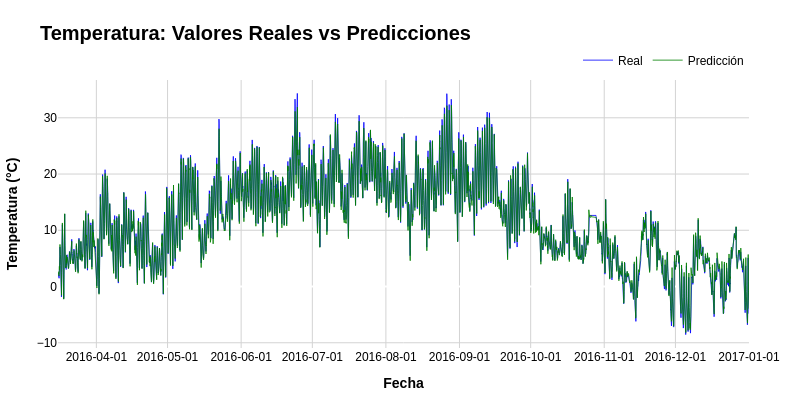

In [30]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(
        x=df_result.index,
        y=df_result['T (degC)'],
        name='Real',
        line=dict(color='blue', width=1),
        opacity=0.8,
        hovertemplate='<b>Fecha</b>: %{x|%Y-%m-%d %H:%M}<br><b>Temperatura</b>: %{y:.2f}°C<extra></extra>'
    )
)

fig.add_trace(
    go.Scatter(
        x=df_result.index,
        y=df_result['pred'],
        name='Predicción',
        line=dict(color='green', width=1),
        opacity=0.8,
        hovertemplate='<b>Fecha</b>: %{x|%Y-%m-%d %H:%M}<br><b>Predicción</b>: %{y:.2f}°C<extra></extra>'
    )
)

# Actualizar diseño como especificaste
fig.update_layout(
    title='<b>Temperatura: Valores Reales vs Predicciones</b>',
    title_font=dict(size=20, family='Arial', color='black'),
    xaxis_title='<b>Fecha</b>',
    yaxis_title='<b>Temperatura (°C)</b>',
    font=dict(family='Arial', size=12, color='black'),
    plot_bgcolor='white',
    paper_bgcolor='white',
    hovermode='x unified',
    height=400,
    margin=dict(l=50, r=50, b=50, t=80),
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1
    )
)

# Formato de ejes
fig.update_xaxes(
    showgrid=True,
    gridcolor='lightgray',
    tickformat='%Y-%m-%d',  
    rangeslider_visible=False  
)

fig.update_yaxes(
    showgrid=True,
    gridcolor='lightgray'
)

fig.show()

In [36]:
r2 = r2_score(df_result['T (degC)'], df_result['pred'])
mse = mean_squared_error(df_result['T (degC)'], df_result['pred'])
rmse = np.sqrt(mse)

# Impresión de resultados
print('R²:', r2)
print('RMSE:', rmse)

R²: 0.990519342613667
RMSE: 0.7558429855968923
